In [2]:
!pip install kaggle

In [3]:
!kaggle datasets download -d sc0v1n0/animal-picture-set-dog-cat

Dataset URL: https://www.kaggle.com/datasets/sc0v1n0/animal-picture-set-dog-cat
License(s): CC0-1.0
animal-picture-set-dog-cat.zip: Skipping, found more recently modified local copy (use --force to force download)


In [4]:
!unzip animal-picture-set-dog-cat.zip

Archive:  animal-picture-set-dog-cat.zip
replace cat_and_dog/animals_enormous/train/cats/0_cat.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [5]:
!pip install scikit-image matplotlib


## HOG

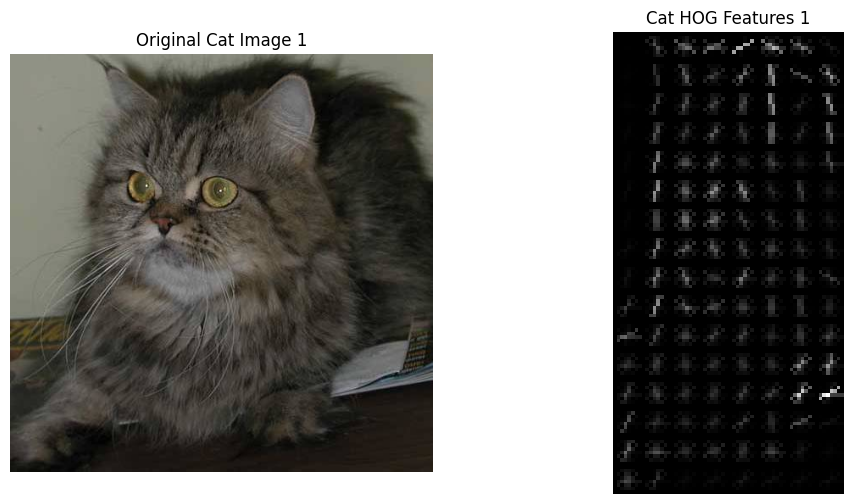

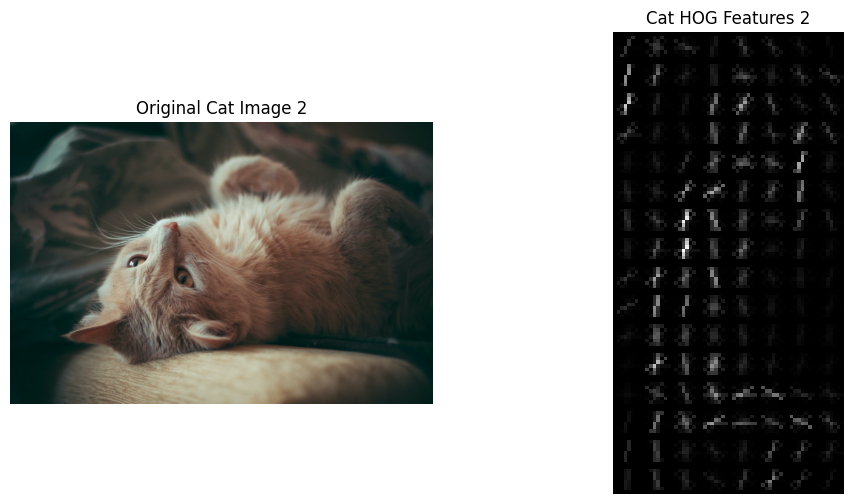

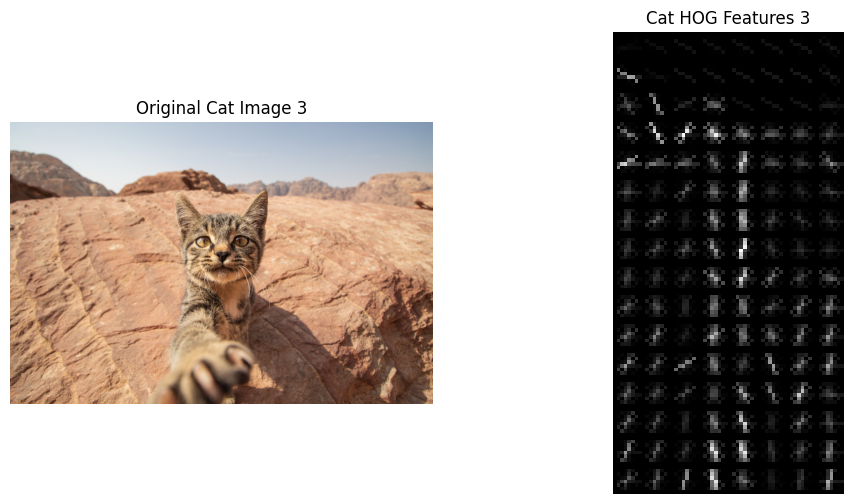

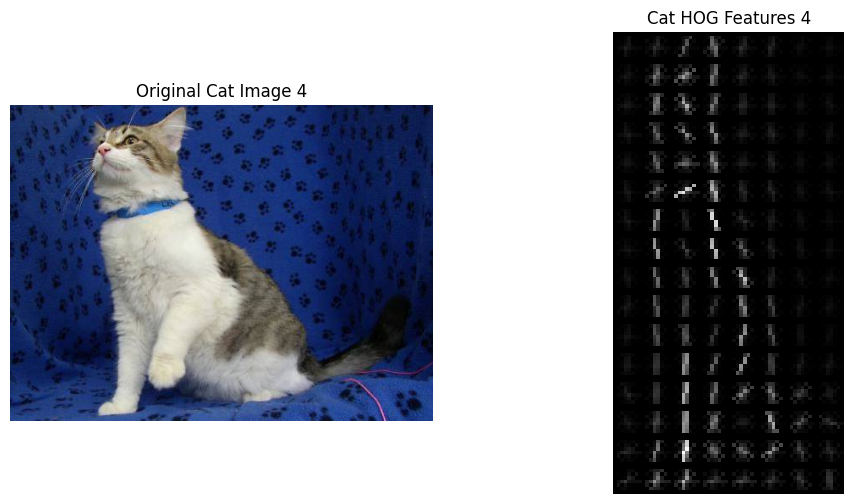

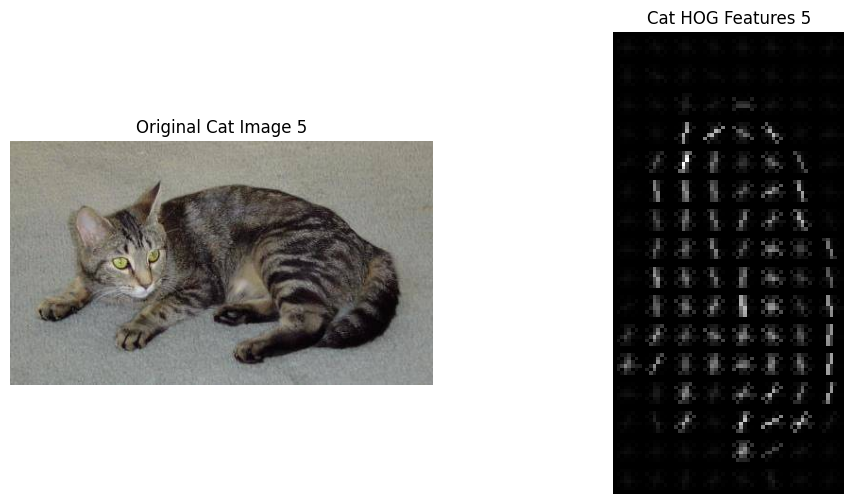

...

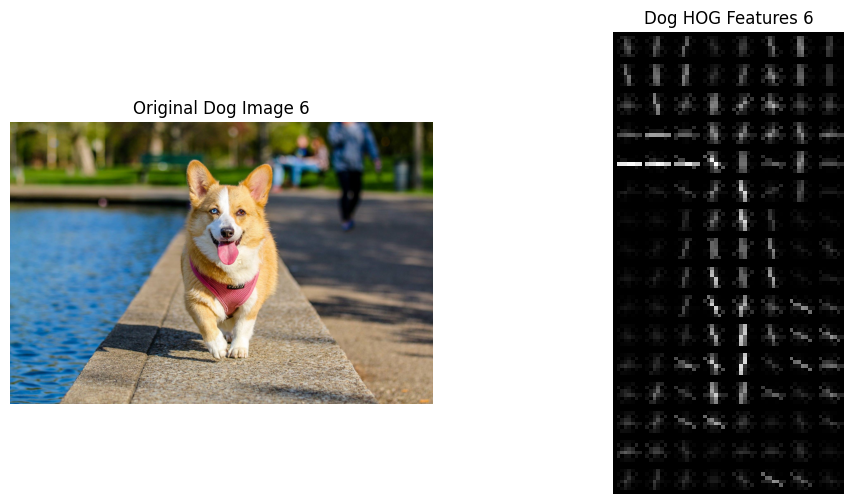

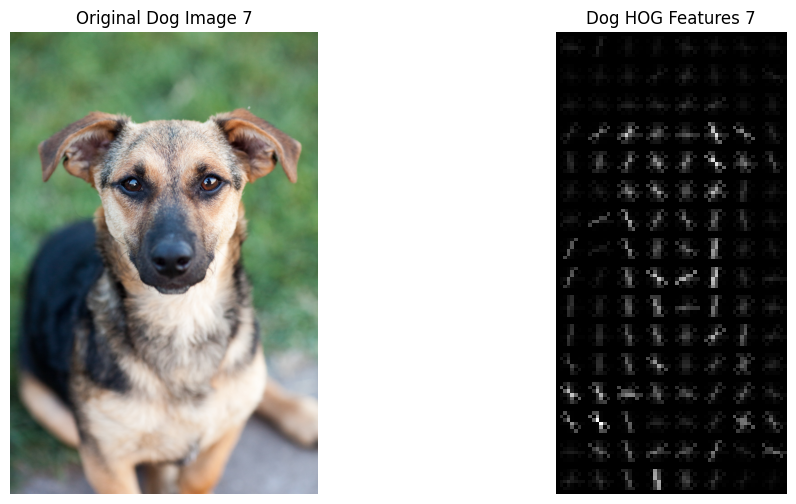

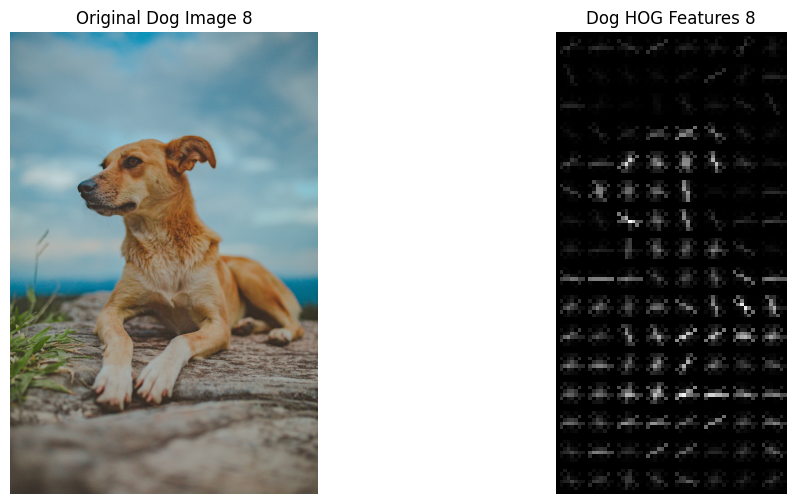

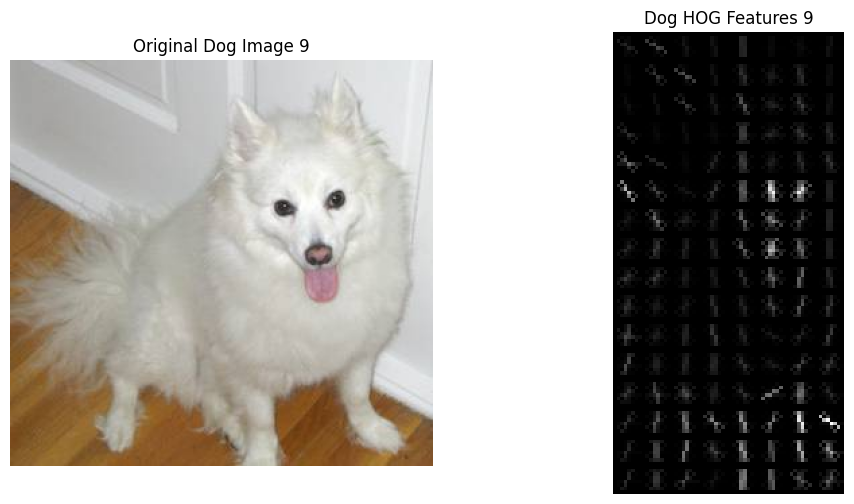

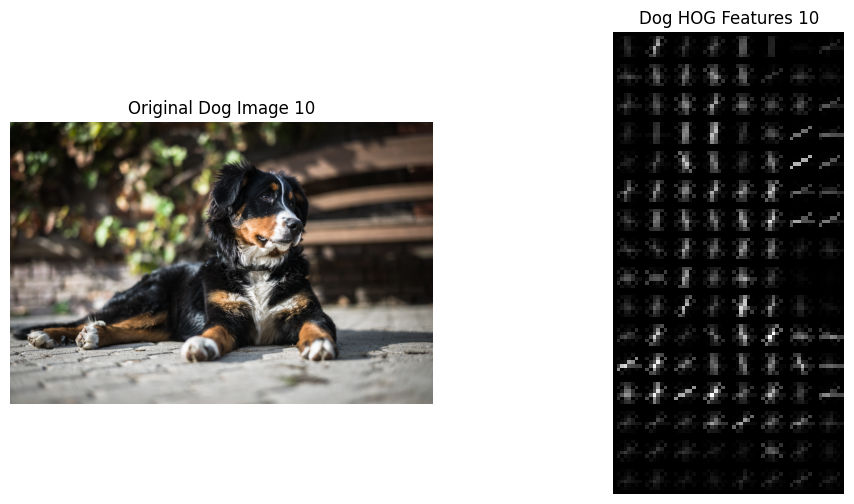

In [9]:
import matplotlib.pyplot as plt
import os
import random
from skimage import io, color, exposure
from skimage.feature import hog
from skimage.transform import resize

# Directory paths for cats and dogs images
cat_dir = 'cat_and_dog/animals_enormous/train/cats/'
dog_dir = 'cat_and_dog/animals_enormous/train/dogs/'

# Function to extract HOG features from an image
def extract_hog(image_path):
    # Load image
    image = io.imread(image_path)

    # Convert to grayscale
    gray_image = color.rgb2gray(image)

    # Resize to a standard size (128x64)
    resized_image = resize(gray_image, (128, 64))

    # Compute HOG features and visualization
    hog_features, hog_image = hog(
        resized_image,
        feature_vector=True,
        visualize=True,
        orientations=9,
        pixels_per_cell=(8, 8),
        cells_per_block=(2, 2),
        block_norm='L2-Hys'
    )

    # Rescale HOG image for better visualization
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    return hog_features, hog_image_rescaled

# Function to process a specified number of images from a directory
def process_images(directory, num_images=10):
    # Get a list of all image files in the directory
    all_images = [img for img in os.listdir(directory) if img.endswith('.png')]

    # Select random imaeges
    selected_images = random.sample(all_images, min(num_images, len(all_images)))

    # Process each selected image
    hog_features_list = []
    hog_images_list = []
    original_images_list = []

    for image_name in selected_images:
        image_path = os.path.join(directory, image_name)
        hog_features, hog_image = extract_hog(image_path)
        hog_features_list.append(hog_features)
        hog_images_list.append(hog_image)
        original_images_list.append(io.imread(image_path))

    return hog_features_list, hog_images_list, original_images_list

# Process 10 cat images and 10 dog images
cat_hog_features, cat_hog_images, cat_original_images = process_images(cat_dir, num_images=10)
dog_hog_features, dog_hog_images, dog_original_images = process_images(dog_dir, num_images=10)

# Display original and HOG images for cats
for i in range(10):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(cat_original_images[i])
    axes[0].set_title(f'Original Cat Image {i+1}')
    axes[0].axis('off')
    axes[1].imshow(cat_hog_images[i], cmap='gray')
    axes[1].set_title(f'Cat HOG Features {i+1}')
    axes[1].axis('off')
    plt.show()

# Display original and HOG images for dogs
for i in range(10):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(dog_original_images[i])
    axes[0].set_title(f'Original Dog Image {i+1}')
    axes[0].axis('off')
    axes[1].imshow(dog_hog_images[i], cmap='gray')
    axes[1].set_title(f'Dog HOG Features {i+1}')
    axes[1].axis('off')
    plt.show()

## SIFT

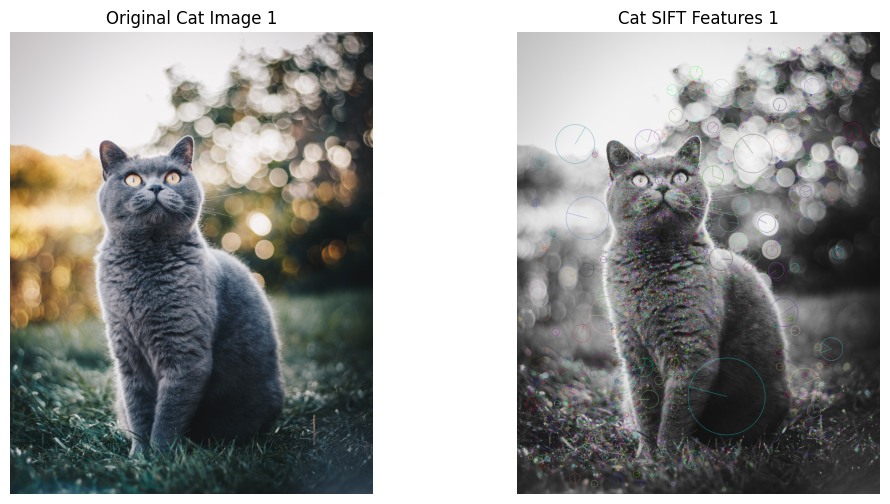

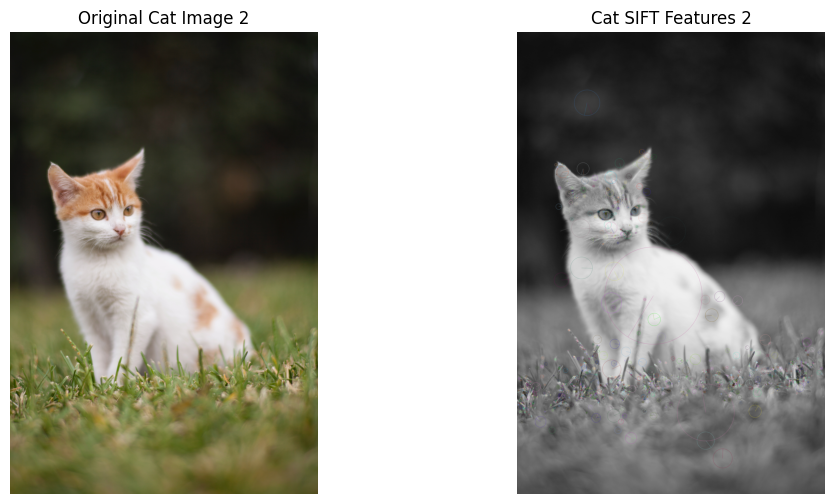

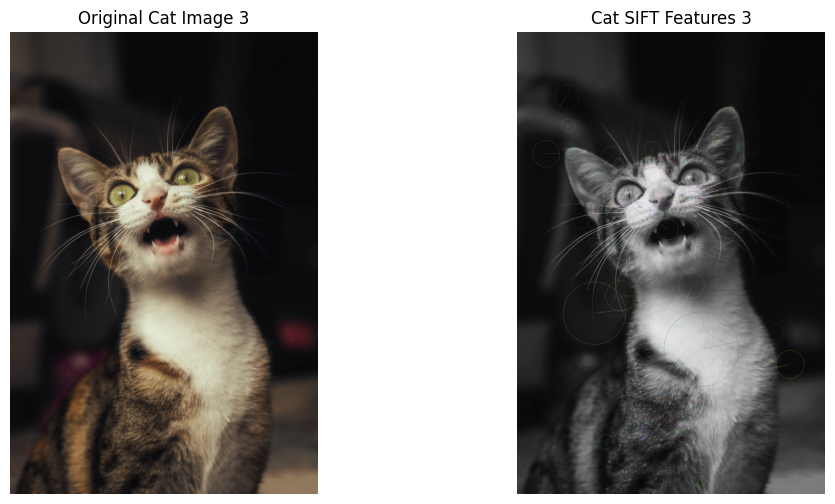

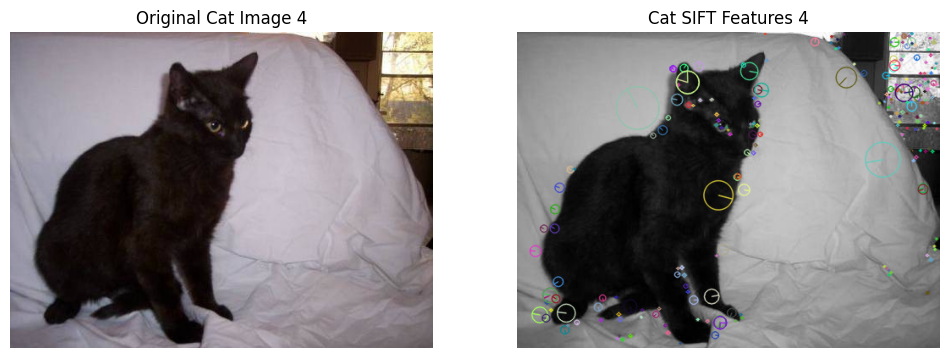

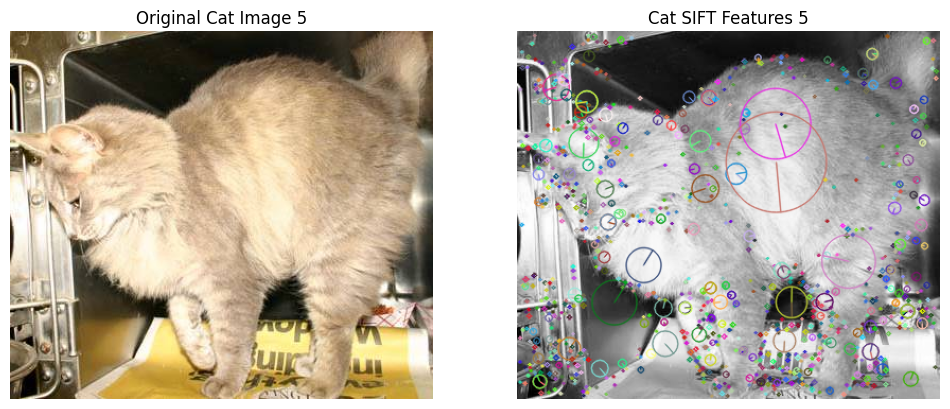

...

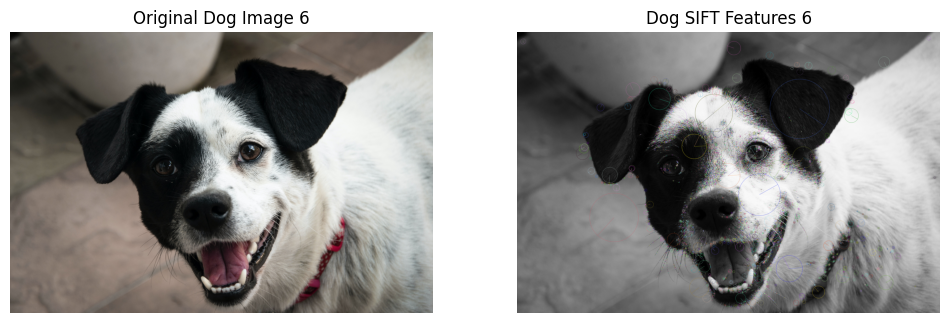

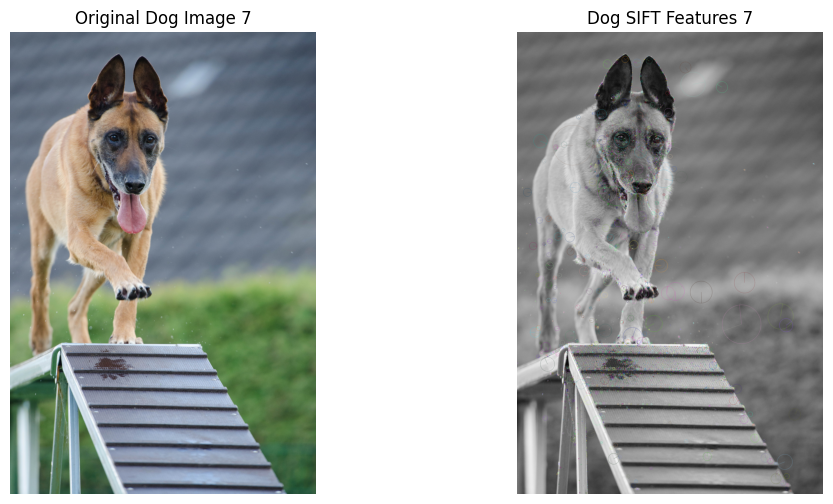

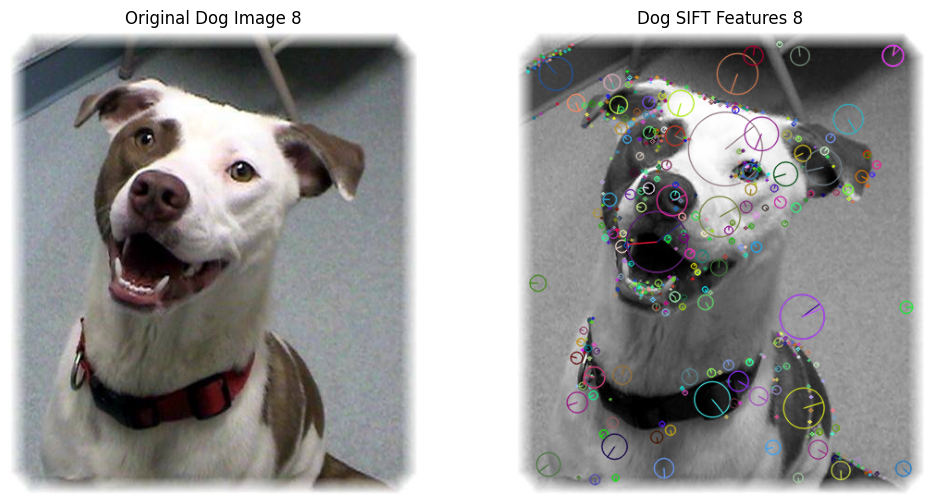

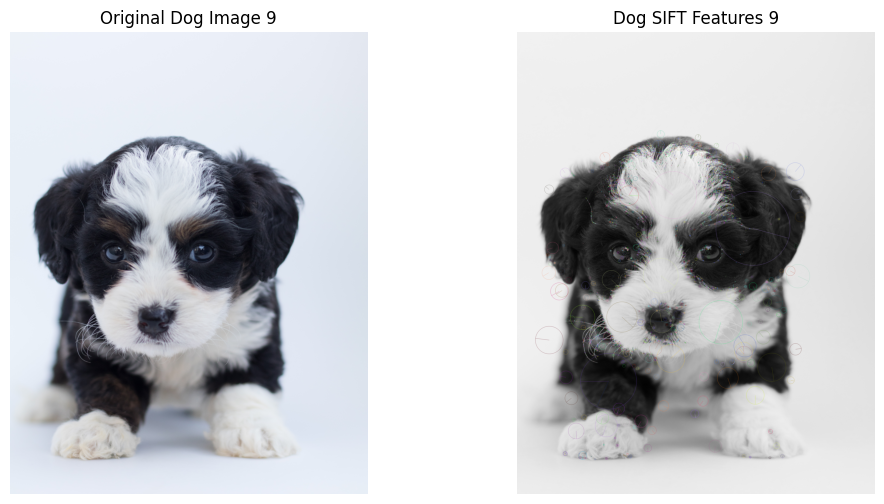

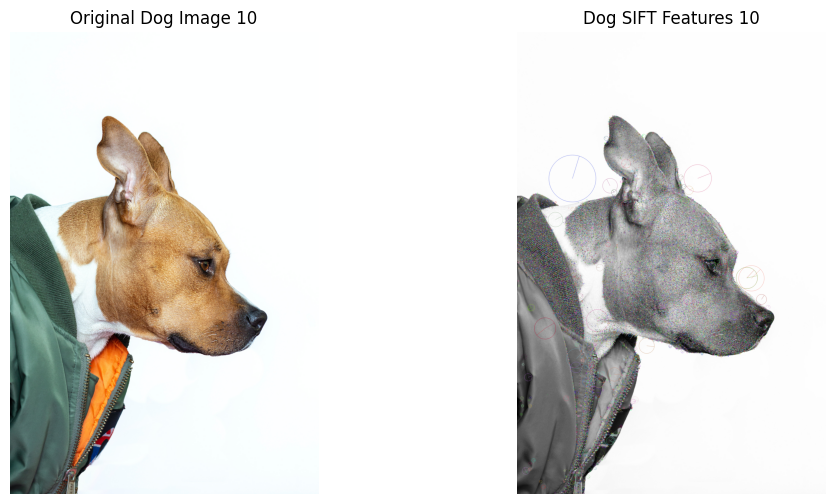

In [10]:
import cv2
import matplotlib.pyplot as plt
import os
import random
from skimage import io, color

# Directory paths for cats and dogs images
cat_dir = 'cat_and_dog/animals_enormous/train/cats/'
dog_dir = 'cat_and_dog/animals_enormous/train/dogs/'

# Function to extract SIFT features from an image
def extract_sift(image_path):
    # Load image
    image = io.imread(image_path)

    # Convert to grayscale
    gray_image = color.rgb2gray(image)

    # Convert to uint8 (required by OpenCV)
    gray_image_uint8 = (gray_image * 255).astype('uint8')

    # Create SIFT detector
    sift = cv2.SIFT_create()

    # Detect keypoints and compute descriptors
    keypoints, descriptors = sift.detectAndCompute(gray_image_uint8, None)

    # Draw keypoints on the image
    image_with_keypoints = cv2.drawKeypoints(
        gray_image_uint8,
        keypoints,
        None,
        flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    )

    return keypoints, descriptors, image_with_keypoints

# Function to process a specified number of images from a directory
def process_images(directory, num_images=10):
    # Get a list of all image files in the directory
    all_images = [img for img in os.listdir(directory) if img.endswith('.png')]

    # Select random imaeges
    selected_images = random.sample(all_images, min(num_images, len(all_images)))

    # Process each selected image
    keypoints_list = []
    descriptors_list = []
    images_with_keypoints_list = []
    original_images_list = []

    for image_name in selected_images:
        image_path = os.path.join(directory, image_name)
        keypoints, descriptors, image_with_keypoints = extract_sift(image_path)
        keypoints_list.append(keypoints)
        descriptors_list.append(descriptors)
        images_with_keypoints_list.append(image_with_keypoints)
        original_images_list.append(io.imread(image_path))

    return keypoints_list, descriptors_list, images_with_keypoints_list, original_images_list

# Process 10 cat images and 10 dog images
cat_keypoints, cat_descriptors, cat_images_with_keypoints, cat_original_images = process_images(cat_dir, num_images=10)
dog_keypoints, dog_descriptors, dog_images_with_keypoints, dog_original_images = process_images(dog_dir, num_images=10)

# Display original and SIFT images for cats
for i in range(10):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(cat_original_images[i])
    axes[0].set_title(f'Original Cat Image {i+1}')
    axes[0].axis('off')
    axes[1].imshow(cat_images_with_keypoints[i])
    axes[1].set_title(f'Cat SIFT Features {i+1}')
    axes[1].axis('off')
    plt.show()

# Display original and SIFT images for dogs
for i in range(10):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(dog_original_images[i])
    axes[0].set_title(f'Original Dog Image {i+1}')
    axes[0].axis('off')
    axes[1].imshow(dog_images_with_keypoints[i])
    axes[1].set_title(f'Dog SIFT Features {i+1}')
    axes[1].axis('off')
    plt.show()

# SURF

In [12]:
import cv2
import matplotlib.pyplot as plt
import os
import random
from skimage import io, color

# Directory paths for cats and dogs images
cat_dir = 'cat_and_dog/animals_enormous/train/cats/'
dog_dir = 'cat_and_dog/animals_enormous/train/dogs/'

# Function to extract SURF features from an image
def extract_surf(image_path):
    # Load image
    image = io.imread(image_path)

    # Convert to grayscale
    gray_image = color.rgb2gray(image)

    # Convert to uint8 (required by OpenCV)
    gray_image_uint8 = (gray_image * 255).astype('uint8')

    # Create SURF detector
    surf = cv2.xfeatures2d.SURF_create(400)

    # Detect keypoints and compute descriptors
    keypoints, descriptors = surf.detectAndCompute(gray_image_uint8, None)

    # Draw keypoints on the image
    image_with_keypoints = cv2.drawKeypoints(
        gray_image_uint8,
        keypoints,
        None,
        flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    )

    return descriptors, image_with_keypoints

# Function to process a specified number of images from a directory
def process_images(directory, num_images=10):
    # Get a list of all image files in the directory
    all_images = [img for img in os.listdir(directory) if img.endswith('.png')]

    # Select random imaeges
    selected_images = random.sample(all_images, min(num_images, len(all_images)))

    # Process each selected image
    descriptors_list = []
    images_with_keypoints_list = []
    original_images_list = []

    for image_name in selected_images:
        image_path = os.path.join(directory, image_name)
        descriptors, image_with_keypoints = extract_surf(image_path)
        descriptors_list.append(descriptors)
        images_with_keypoints_list.append(image_with_keypoints)
        original_images_list.append(io.imread(image_path))

    return descriptors_list, images_with_keypoints_list, original_images_list

# Process 10 cat images and 10 dog images
cat_surf_descriptors, cat_surf_images, cat_original_images = process_images(cat_dir, num_images=10)
dog_surf_descriptors, dog_surf_images, dog_original_images = process_images(dog_dir, num_images=10)

# Display original and SURF images for cats
for i in range(10):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(cat_original_images[i])
    axes[0].set_title(f'Original Cat Image {i+1}')
    axes[0].axis('off')
    axes[1].imshow(cat_surf_images[i])
    axes[1].set_title(f'Cat SURF Features {i+1}')
    axes[1].axis('off')
    plt.show()

# Display original and SURF images for dogs
for i in range(10):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(dog_original_images[i])
    axes[0].set_title(f'Original Dog Image {i+1}')
    axes[0].axis('off')
    axes[1].imshow(dog_surf_images[i])
    axes[1].set_title(f'Dog SURF Features {i+1}')
    axes[1].axis('off')
    plt.show()

error: OpenCV(4.11.0) /io/opencv_contrib/modules/xfeatures2d/src/surf.cpp:1026: error: (-213:The function/feature is not implemented) This algorithm is patented and is excluded in this configuration; Set OPENCV_ENABLE_NONFREE CMake option and rebuild the library in function 'create'


In [16]:
!pip install opencv-contrib-python --upgrade

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 MB 13.2 MB/s eta 0:00:00
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.10.0.84
    Uninstalling opencv-contrib-python-4.10.0.84:
      Successfully uninstalled opencv-contrib-python-4.10.0.84


## LBP

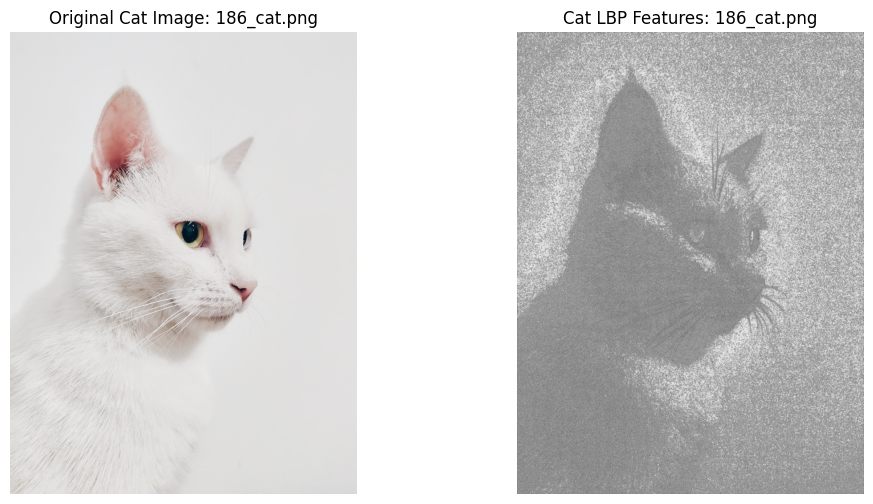

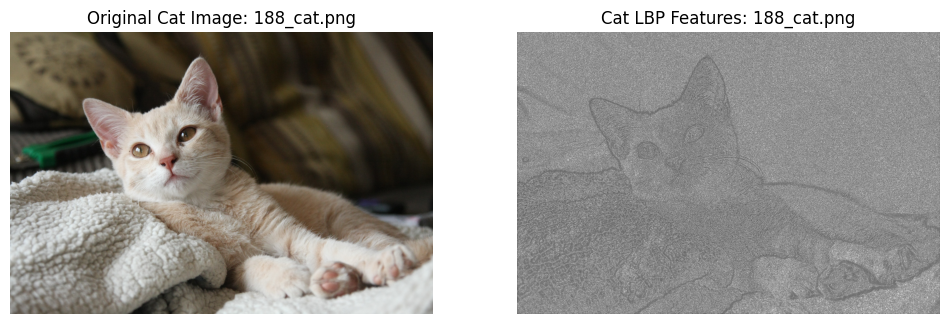

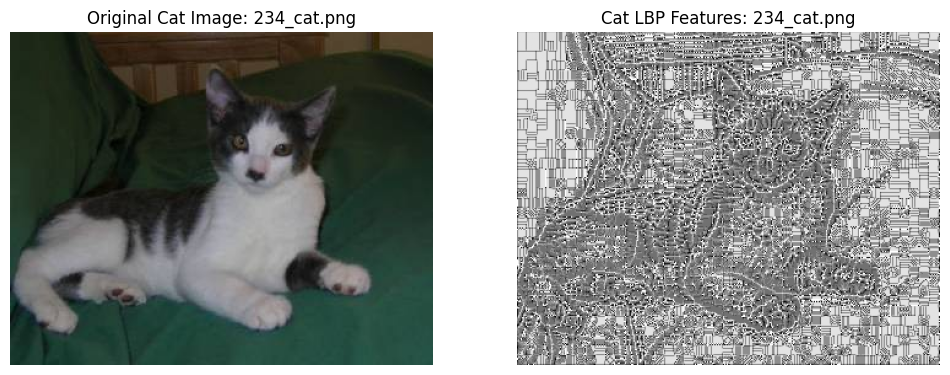

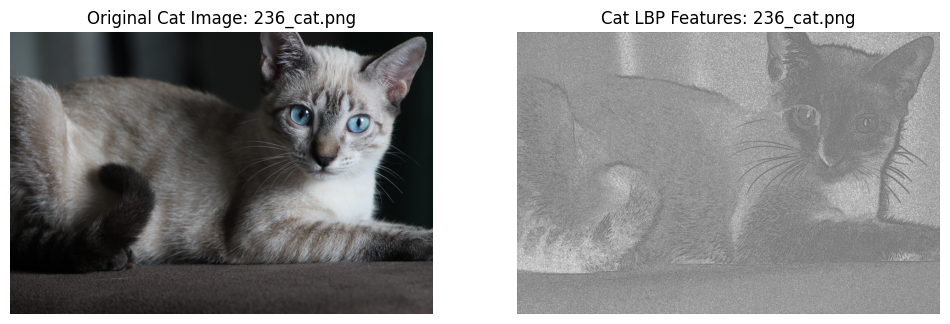

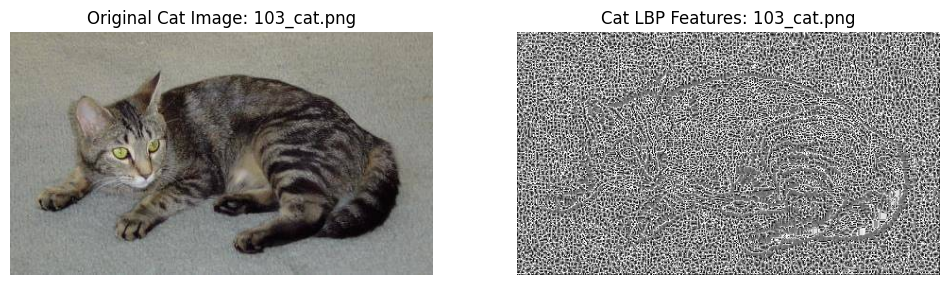

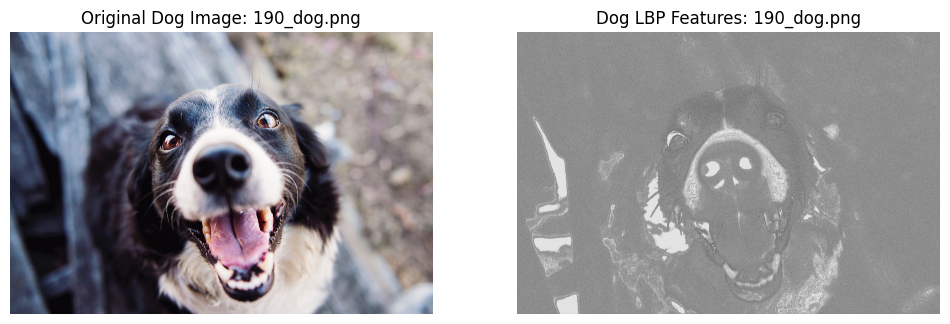

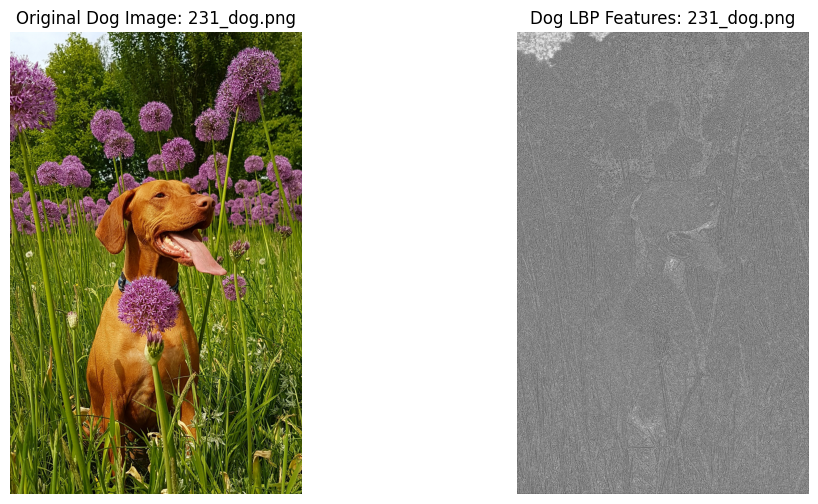

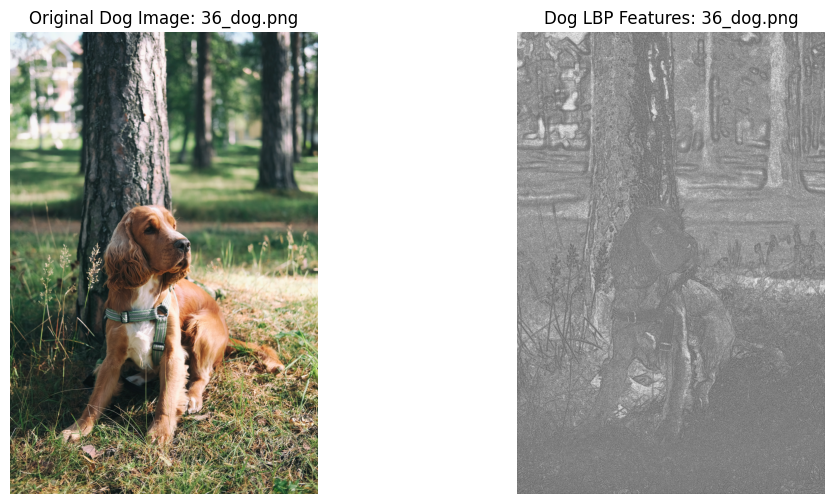

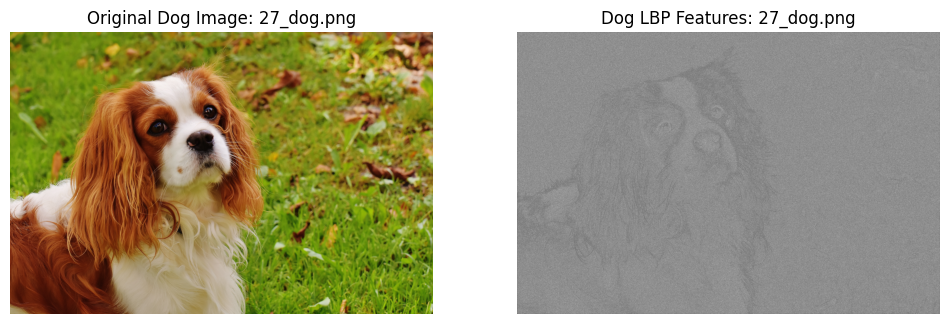

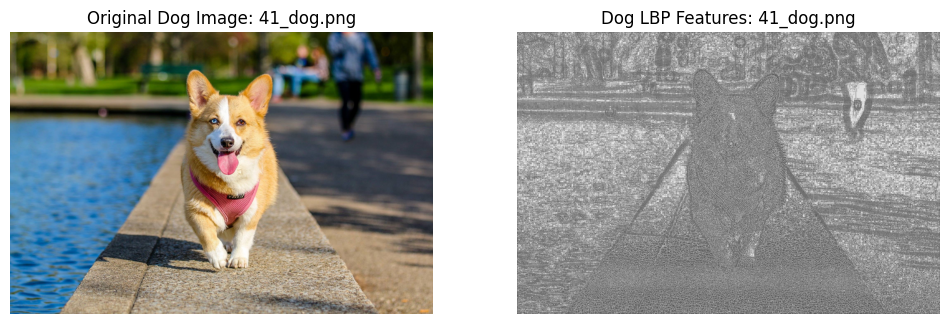

Total processed cat images: 10
Total processed dog images: 10
Feature vector length for each image: 10


In [14]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, color
from skimage.feature import local_binary_pattern

cat_dir = 'cat_and_dog/animals_enormous/train/cats/'
dog_dir = 'cat_and_dog/animals_enormous/train/dogs/'

# LBP Parameters
radius = 1  # Radius of neighborhood
n_points = 8 * radius  # Number of points in LBP

# Function to extract LBP features from an image
def extract_lbp(image_path):
    # Load image
    image = io.imread(image_path)

    # Convert to grayscale and ensure integer dtype
    gray_image = (color.rgb2gray(image) * 255).astype('uint8')  # Convert to uint8

    # Compute LBP
    lbp_image = local_binary_pattern(gray_image, n_points, radius, method="uniform")

    # Compute LBP histogram as a feature vector
    lbp_hist, _ = np.histogram(lbp_image.ravel(), bins=np.arange(0, n_points + 3), density=True)

    return lbp_hist, lbp_image

# Function to process multiple images from a directory
def process_images(directory, num_images=10):
    features_list = []
    lbp_images_list = []

    image_files = [f for f in os.listdir(directory) if f.endswith('.png')][:num_images]  # Select first num_images images

    for image_name in image_files:
        image_path = os.path.join(directory, image_name)
        features, lbp_image = extract_lbp(image_path)
        features_list.append(features)
        lbp_images_list.append(lbp_image)

    return features_list, lbp_images_list, image_files

# Process 10 images from cats and dogs directories
cat_features, cat_lbp_images, cat_files = process_images(cat_dir, num_images=10)
dog_features, dog_lbp_images, dog_files = process_images(dog_dir, num_images=10)

# Display first 5 cat and dog LBP images
for i in range(5):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Display original cat image
    cat_image_path = os.path.join(cat_dir, cat_files[i])
    axes[0].imshow(io.imread(cat_image_path))
    axes[0].set_title(f'Original Cat Image: {cat_files[i]}')
    axes[0].axis('off')

    # Display LBP image
    axes[1].imshow(cat_lbp_images[i], cmap='gray')
    axes[1].set_title(f'Cat LBP Features: {cat_files[i]}')
    axes[1].axis('off')

    plt.show()

for i in range(5):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Display original dog image
    dog_image_path = os.path.join(dog_dir, dog_files[i])
    axes[0].imshow(io.imread(dog_image_path))
    axes[0].set_title(f'Original Dog Image: {dog_files[i]}')
    axes[0].axis('off')

    # Display LBP image
    axes[1].imshow(dog_lbp_images[i], cmap='gray')
    axes[1].set_title(f'Dog LBP Features: {dog_files[i]}')
    axes[1].axis('off')

    plt.show()

# Print dataset information
print(f"Total processed cat images: {len(cat_features)}")
print(f"Total processed dog images: {len(dog_features)}")
print("Feature vector length for each image:", len(cat_features[0]))


## Gabor Filters


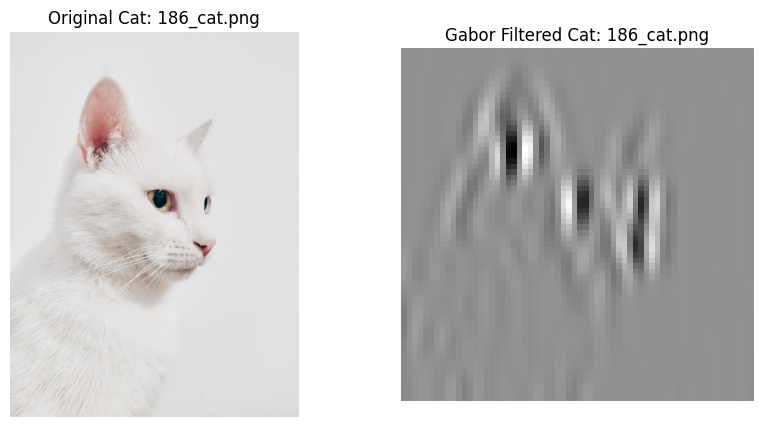

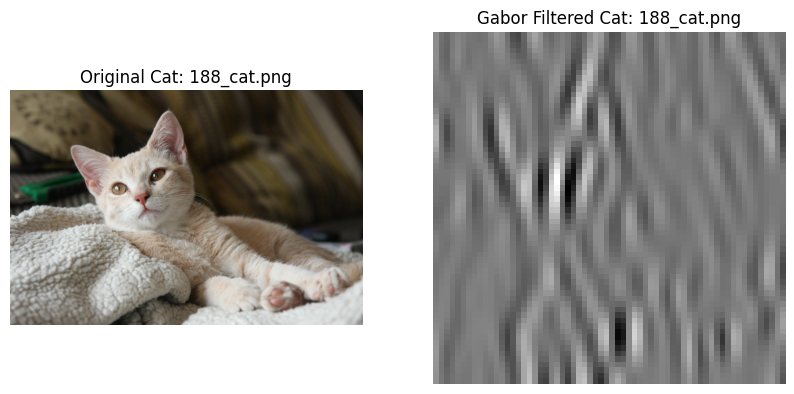

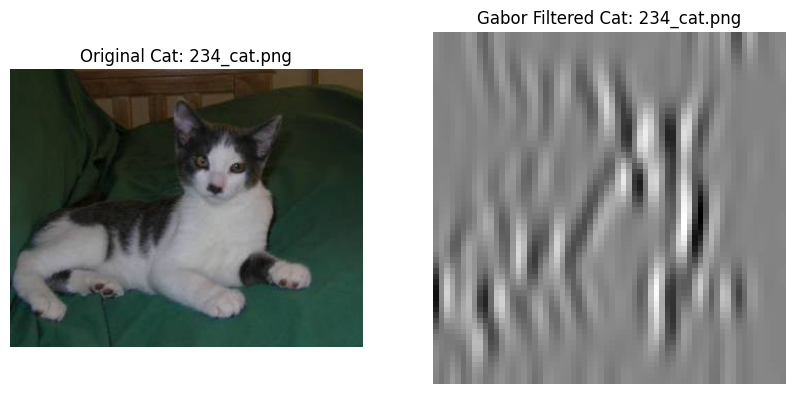

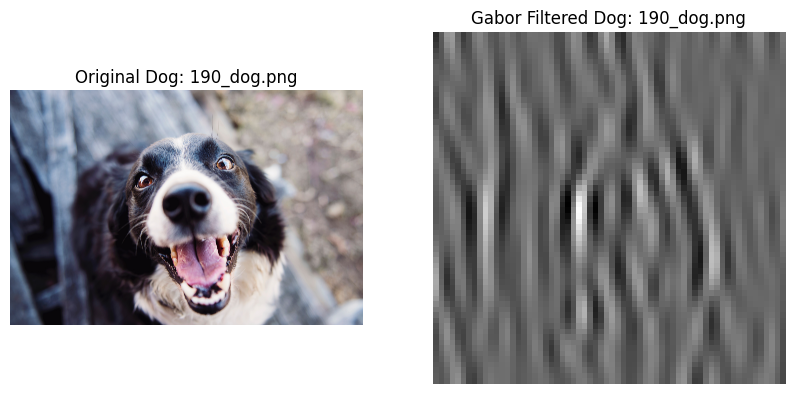

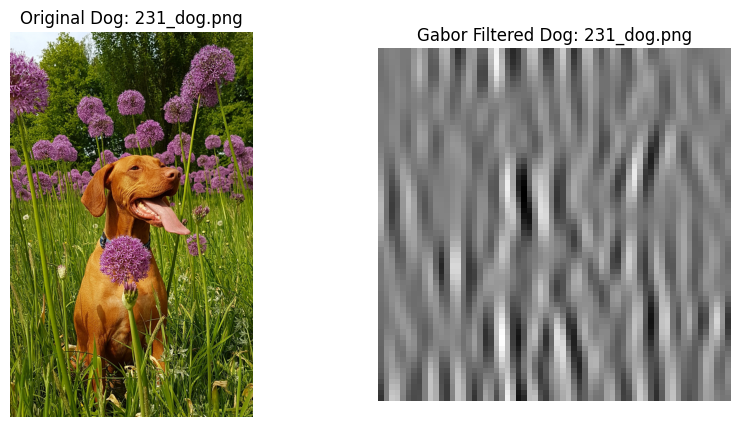

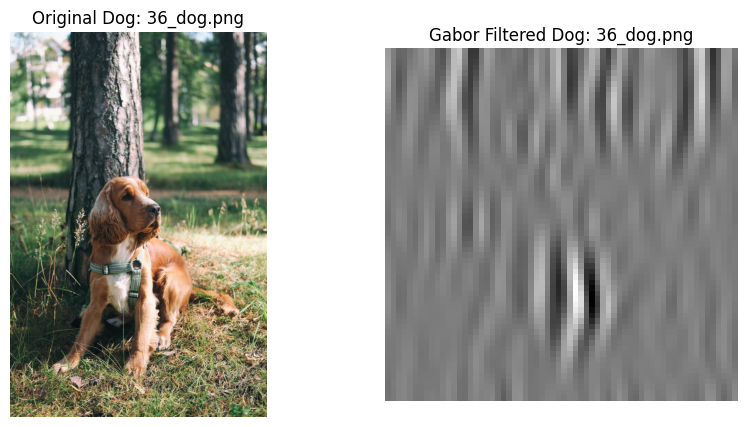

Total processed cat images: 10
Total processed dog images: 10
Feature vector length for each image: 8


In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, color
from skimage.filters import gabor
from skimage.transform import resize

# Define directories for images
cat_dir = 'cat_and_dog/animals_enormous/train/cats/'
dog_dir = 'cat_and_dog/animals_enormous/train/dogs/'

# Gabor filter parameters (Reduced to 2 frequencies and 2 orientations for speed)
frequencies = [0.2, 0.4]
orientations = [0, np.pi/4]

# Function to apply Gabor filter efficiently
def apply_gabor(image_path):
    # Load and resize image (reducing size speeds up processing)
    image = io.imread(image_path)
    gray_image = color.rgb2gray(image)
    resized_image = resize(gray_image, (64, 64))  # Resize to 64x64

    # Apply Gabor filters at different orientations & frequencies
    feature_vector = []
    gabor_images = []

    for freq in frequencies:
        for theta in orientations:
            filtered, _ = gabor(resized_image, frequency=freq, theta=theta)
            gabor_images.append(filtered)
            feature_vector.append(filtered.mean())  # Mean value as feature
            feature_vector.append(filtered.var())   # Variance as feature

    return np.array(feature_vector), gabor_images

# Function to process images in a directory (limits to 10 images)
def process_images(directory, num_images=10):
    features_list = []
    gabor_images_list = []
    image_files = [f for f in os.listdir(directory) if f.endswith('.png')][:num_images]

    for image_name in image_files:
        image_path = os.path.join(directory, image_name)
        features, gabor_images = apply_gabor(image_path)
        features_list.append(features)
        gabor_images_list.append(gabor_images)

    return features_list, gabor_images_list, image_files

# Process 10 images from cats and dogs directories
cat_features, cat_gabor_images, cat_files = process_images(cat_dir, num_images=10)
dog_features, dog_gabor_images, dog_files = process_images(dog_dir, num_images=10)

# Display original and first Gabor-filtered images for 3 cats & 3 dogs (for quick visualization)
for i in range(3):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Original Cat Image
    cat_image_path = os.path.join(cat_dir, cat_files[i])
    axes[0].imshow(io.imread(cat_image_path))
    axes[0].set_title(f'Original Cat: {cat_files[i]}')
    axes[0].axis('off')

    # First Gabor-filtered Cat Image
    axes[1].imshow(cat_gabor_images[i][0], cmap='gray')
    axes[1].set_title(f'Gabor Filtered Cat: {cat_files[i]}')
    axes[1].axis('off')

    plt.show()

for i in range(3):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Original Dog Image
    dog_image_path = os.path.join(dog_dir, dog_files[i])
    axes[0].imshow(io.imread(dog_image_path))
    axes[0].set_title(f'Original Dog: {dog_files[i]}')
    axes[0].axis('off')

    # First Gabor-filtered Dog Image
    axes[1].imshow(dog_gabor_images[i][0], cmap='gray')
    axes[1].set_title(f'Gabor Filtered Dog: {dog_files[i]}')
    axes[1].axis('off')

    plt.show()

# Print dataset information
print(f"Total processed cat images: {len(cat_features)}")
print(f"Total processed dog images: {len(dog_features)}")
print("Feature vector length for each image:", len(cat_features[0]))
